In [16]:
import osmnx as ox
import os as os
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import networkx as nx 
from shapely.geometry import Point, Polygon  
import geopandas as gpd 


Geocodificando la ciudad de Córdoba, Argentina...
Error al geocodificar Córdoba: `query` must be a string if `by_osmid` is True.
Mostrando el polígono geocodificado...


<Axes: >

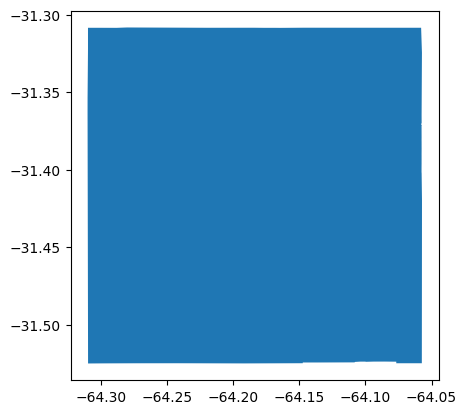

In [17]:
# Definir el polígono para la ciudad de Córdoba, Argentina
print("Geocodificando la ciudad de Córdoba, Argentina...")
try:
    admin_district = ox.geocode_to_gdf(5167559, by_osmid=True)
    print("Geocodificación exitosa.")
except Exception as e:
    print(f"Error al geocodificar Córdoba: {e}")
    admin_district = ox.geocode_to_gdf(
        "Córdoba, Córdoba, Argentina"
    )

print("Mostrando el polígono geocodificado...")
admin_district.plot()

In [18]:
admin_poly = admin_district.geometry.values[0]

# Guardar imagen del mapa
png_path = os.path.join("map.png")
plt.savefig(png_path, dpi=300, bbox_inches='tight')

# Cargar el grafo de la red de calles dentro de ese polígono
print("Cargando el grafo de la red de calles de Córdoba, Argentina...")
G = ox.graph_from_polygon(admin_poly, network_type='walk')
print("Grafo cargado exitosamente.")

print('\nAnálisis de la red de calles de Córdoba, Argentina:')
print('Número de intersecciones (nodos): ', G.number_of_nodes())
print('Número de segmentos de carretera (aristas):',  G.number_of_edges())

Cargando el grafo de la red de calles de Córdoba, Argentina...
Grafo cargado exitosamente.

Análisis de la red de calles de Córdoba, Argentina:
Número de intersecciones (nodos):  37068
Número de segmentos de carretera (aristas): 115444


<Figure size 640x480 with 0 Axes>


Visualizando el grafo...


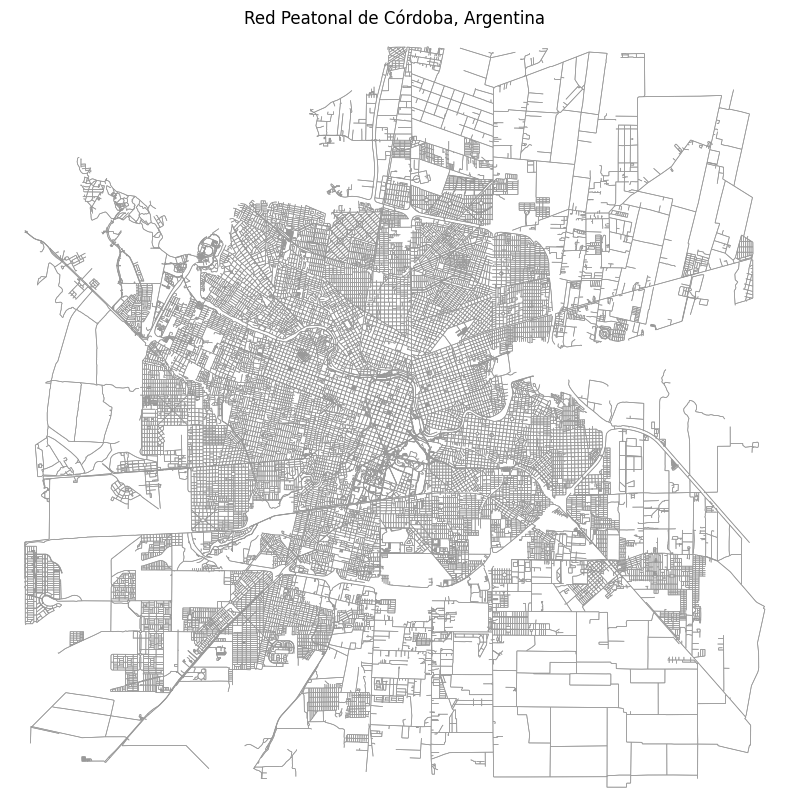

In [19]:
print("\nVisualizando el grafo...")
fig, ax = ox.plot_graph(G, figsize=(10, 10), node_size=0, bgcolor='white', edge_linewidth=0.5, show=False, close=False)
plt.title("Red Peatonal de Córdoba, Argentina")
plt.show()

In [20]:
display(G.nodes())

NodeView((249490924, 249490955, 249491056, 249491057, 252160525, 252162400, 252162414, 252162416, 252162568, 252162684, 252162692, 252218346, 252219369, 252221954, 252221955, 252221959, 252221966, 252221967, 272172177, 279091541, 279091605, 279091606, 279091811, 279091946, 279091950, 279109332, 279109333, 279109334, 279109336, 279109337, 279109338, 279109340, 279109342, 279109344, 279109346, 279109347, 279109348, 279109402, 279109544, 279110665, 279112019, 279112090, 279112091, 279112092, 279112815, 279112816, 279112817, 279112905, 279112906, 279112907, 279112908, 279113049, 279113050, 279113051, 279113052, 279113510, 279114009, 279114010, 279114015, 279114016, 279114017, 279114897, 279114898, 279114911, 279114923, 279114934, 279114935, 279114937, 279114938, 279114952, 279114954, 279114955, 279114956, 279114965, 279114970, 279114971, 279114972, 279114973, 279114976, 279114979, 279114982, 279116721, 279116722, 279116723, 279116724, 279116737, 279116744, 279116751, 279117103, 279117104, 

In [21]:
# Define the walking speed (5 km/h -> 1.39 m/s)
walking_speed = 1.39  # in meters per second

# Calculate travel time for each edge
for u, v, data in G.edges(data=True):
    print(u, v, data)
    data['travel_time'] = data['length'] / walking_speed

# Pick a center node
center_node = list(G.nodes())[30]  # starting point

# Generate isochrones
isochrone_times = [5, 10, 20, 30]  # isochrones in minutes

249490924 1183719611 {'osmid': 170994019, 'highway': 'primary', 'lanes': '2', 'name': 'Avenida Amadeo Sabattini', 'oneway': False, 'ref': 'RN1V09', 'reversed': True, 'length': np.float64(378.9820778008299), 'geometry': <LINESTRING (-64.122 -31.446, -64.121 -31.447, -64.12 -31.448, -64.12 -31.44...>}
249490955 6010559553 {'osmid': 637577759, 'highway': 'service', 'oneway': False, 'reversed': False, 'length': np.float64(33.840606965342786)}
249491056 9864783379 {'osmid': 354342185, 'highway': 'primary', 'lanes': '2', 'maxspeed': '60', 'name': 'Avenida Juan B. Justo', 'oneway': False, 'ref': 'RN9', 'reversed': False, 'length': np.float64(103.56744231455635)}
249491056 7847605261 {'osmid': 354342185, 'highway': 'primary', 'lanes': '2', 'maxspeed': '60', 'name': 'Avenida Juan B. Justo', 'oneway': False, 'ref': 'RN9', 'reversed': True, 'length': np.float64(5.537523311942684)}
249491056 1739473086 {'osmid': 270263191, 'highway': 'residential', 'oneway': False, 'reversed': True, 'length': np.f

/tmp/ipykernel_28598/2299122273.py:12: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  polygon = Polygon(gpd.GeoSeries(node_points).unary_union.convex_hull)
/tmp/ipykernel_28598/2299122273.py:12: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  polygon = Polygon(gpd.GeoSeries(node_points).unary_union.convex_hull)
/tmp/ipykernel_28598/2299122273.py:12: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  polygon = Polygon(gpd.GeoSeries(node_points).unary_union.convex_hull)
/tmp/ipykernel_28598/2299122273.py:12: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  polygon = Polygon(gpd.GeoSeries(node_points).unary_union.convex_hull)


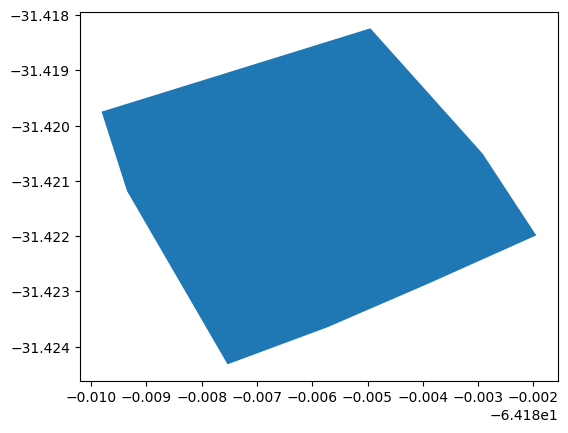

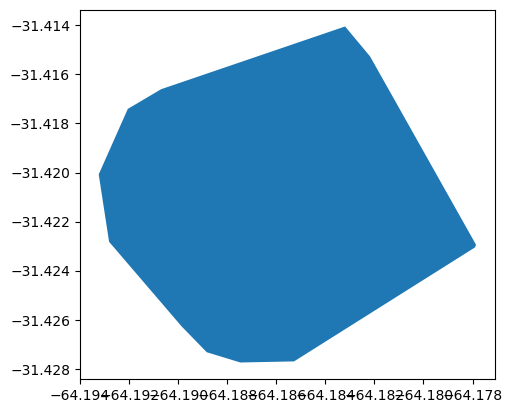

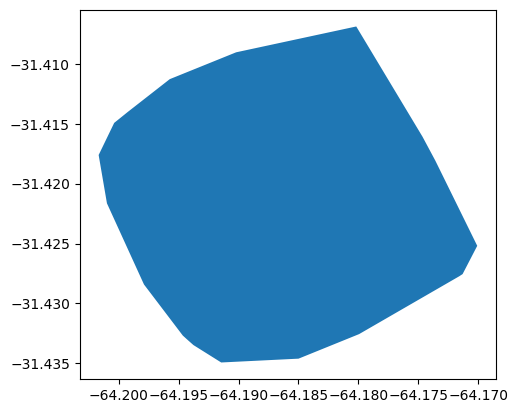

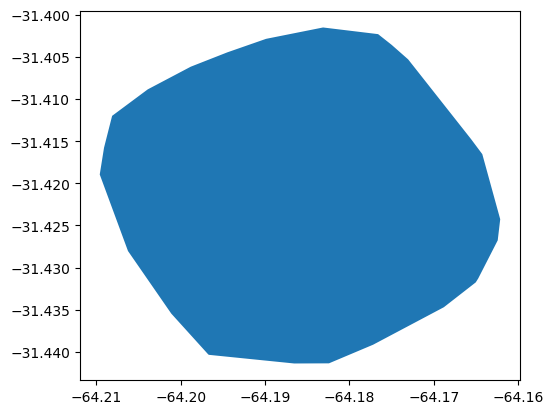

In [22]:
isochrone_polys = []

for time in isochrone_times:
    subgraph = nx.ego_graph(G, 
                            center_node, 
                            radius=time*60, 
                            distance='travel_time')

    node_points = [Point((data['x'], data['y'])) 
                   for node, data in subgraph.nodes(data=True)]

    polygon = Polygon(gpd.GeoSeries(node_points).unary_union.convex_hull)
    gpd.GeoDataFrame([polygon], columns = ['geometry']).plot()
    isochrone_polys.append(gpd.GeoSeries([polygon]))

In [23]:
output_dir = "images"
os.makedirs(output_dir, exist_ok=True)

In [24]:
ox.settings.use_cache = True
ox.settings.log_console = True

In [25]:
# Proyectar grafo a CRS métrico
G_proj = ox.project_graph(G)
nodes_proj = ox.graph_to_gdfs(G_proj, nodes=True, edges=False)
display(nodes_proj.head())

,y,x,street_count,highway,railway,ref,geometry
osmid,,,,,,,
249490924,6.520383e+06,393387.017601,1,NaN,NaN,NaN,POINT (393387.018 6520383.41)
1183719611,6.520109e+06,393646.701780,4,traffic_signals,NaN,NaN,POINT (393646.702 6520108.726)
249490955,6.522597e+06,396538.360700,1,NaN,NaN,NaN,POINT (396538.361 6522597.258)
6010559553,6.522618e+06,396564.882174,4,NaN,NaN,NaN,POINT (396564.882 6522618.272)
249491056,6.531240e+06,388123.639511,3,NaN,NaN,NaN,POINT (388123.64 6531239.638)


In [26]:
# Nodo de inicio: centroide proyectado

# Coordenadas del punto inicial (WGS84)
lat, lon = -31.4166867,-64.1834193

# Crear GeoSeries y proyectar al CRS del grafo
point_wgs = gpd.GeoSeries([gpd.points_from_xy([lon], [lat])[0]], crs="EPSG:4326")
point_proj = point_wgs.to_crs(G_proj.graph['crs'])
x, y = point_proj.geometry.iloc[0].x, point_proj.geometry.iloc[0].y

# Obtener el nodo más cercano a esas coordenadas proyectadas
center_node = ox.distance.nearest_nodes(G_proj, X=x, Y=y)


In [27]:
# Definir tiempos y distancias
trip_times = [5, 10, 15, 20, 30]  # minutos
meters_per_minute = 80  # m/min
travel_distances = [t * meters_per_minute for t in trip_times]

In [28]:
# Generar polígonos de isócrona
def make_iso_polys(G, center_node, distances):
    polys = []
    for dist in distances:
        subgraph = nx.ego_graph(G, center_node, radius=dist, distance='length')
        nodes_gdf = ox.graph_to_gdfs(subgraph, nodes=True, edges=False)
        if not nodes_gdf.empty:
            union = nodes_gdf.union_all()
            buffered = gpd.GeoSeries([union]).buffer(100)  # Aumentar buffer para visibilidad
            polys.append(buffered)
        else:
            polys.append(gpd.GeoSeries())
    return polys

isochrone_polys = make_iso_polys(G_proj, center_node, travel_distances)
print(isochrone_polys)


[0    POLYGON ((387089.778 6523804.485, 387090.255 6...
dtype: geometry, 0    POLYGON ((386731.339 6523699.982, 386725.63 65...
dtype: geometry, 0    POLYGON ((386424.7 6523818.106, 386422.363 652...
dtype: geometry, 0    POLYGON ((386043.355 6523944.248, 386041.337 6...
dtype: geometry, 0    POLYGON ((385256.328 6524237.93, 385256.115 65...
dtype: geometry]


0 (0    POLYGON ((385256.328 6524237.93, 385256.115 65...
dtype: geometry, 30)
1 (0    POLYGON ((386043.355 6523944.248, 386041.337 6...
dtype: geometry, 20)
2 (0    POLYGON ((386424.7 6523818.106, 386422.363 652...
dtype: geometry, 15)
3 (0    POLYGON ((386731.339 6523699.982, 386725.63 65...
dtype: geometry, 10)


/tmp/ipykernel_28598/1630714959.py:6: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap('plasma')


4 (0    POLYGON ((387089.778 6523804.485, 387090.255 6...
dtype: geometry, 5)


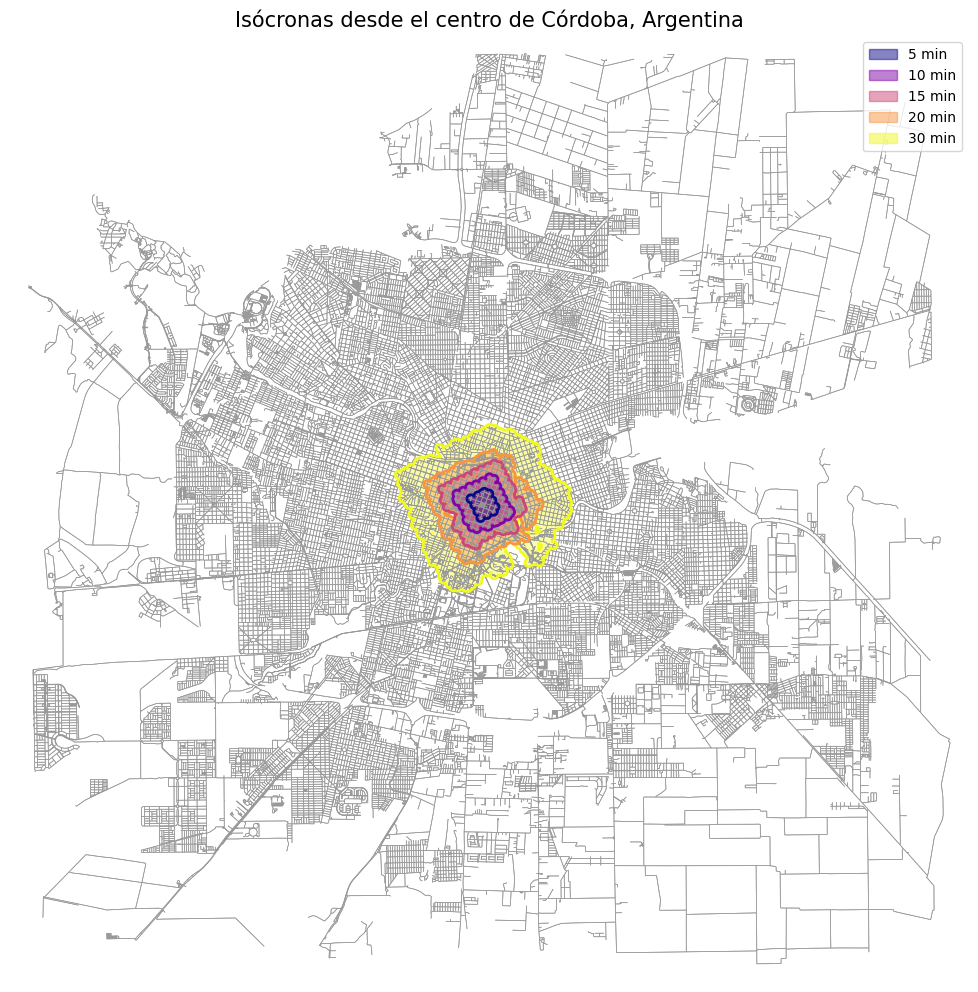

In [29]:
# 7. Visualización
import numpy as np

fig, ax = plt.subplots(figsize=(10, 10))
# Generar paleta dinámica con la misma longitud que trip_times
cmap = plt.cm.get_cmap('plasma')
colors = [cmap(v) for v in np.linspace(0, 1, len(trip_times))]

pairs = list(zip(isochrone_polys, trip_times))

# Dibujar isócronas (recorremos en orden inverso para que las más grandes queden detrás)
for idx, (poly, time) in enumerate(reversed(pairs)):
    # Mapear color al tiempo correspondiente
    color = colors[len(trip_times) - 1 - idx]
    print(idx, (poly, time))
    try:
        # Comprobaciones seguras antes de plotear
        if isinstance(poly, gpd.GeoSeries) and not poly.empty:
            geom = poly.geometry.iloc[0]
            if geom is not None and not geom.is_empty:
                gpd.GeoSeries([geom]).plot(ax=ax, color=color, alpha=0.4)
                gpd.GeoSeries([geom.boundary]).plot(ax=ax, color=color, linewidth=2)
    except Exception as e:
        print("salteando polígono vacío o inválido:", e)
        continue

# Leyenda manual (orden ascendente de tiempos)
handles = [
    mpatches.Patch(color=colors[i], alpha=0.5, label=f'{t} min')
    for i, t in enumerate(trip_times)
]

ox.plot_graph(G_proj, ax=ax, node_size=0, edge_linewidth=0.5, show=False)
ax.set_title("Isócronas desde el centro de Córdoba, Argentina", fontsize=15)
plt.legend(handles=handles)
plt.tight_layout()

# Guardar imagen del mapa
png_path = os.path.join(output_dir, "isochrones_map.png")
plt.savefig(png_path, dpi=300, bbox_inches='tight')

plt.show()